Unable to display or save graph when using geom_path

(Internal error: NullPointerException : \<no message\> due to sampling,
check out[5])

https://github.com/JetBrains/lets-plot/issues/1168 [CLOSED]

In [1]:
from lets_plot import *
import pandas as pd

LetsPlot.setup_html()


In [2]:
core_10004_1A_1 = pd.read_csv("Data/core_10004_1A_1.csv", sep='\t')
core_10004_1A_1.head(3)

,core_id,section_no,tube_length_cm,pixel_no,depth_cm,red,green,blue,alpha,l_star,a_star,b_star,hue,depth_m,red_null,green_null,blue_null,hue_null,channel,value
0,10004_1A_1,1,118.2,0,0.0,71,72,54,255,29.89502,-3.9375,10.671875,32,0.0,71.0,72.0,54.0,32.0,l_star_null,29.895020
1,10004_1A_1,1,118.2,0,0.0,71,72,54,255,29.89502,-3.9375,10.671875,32,0.0,71.0,72.0,54.0,32.0,a_star_null,-3.937500
2,10004_1A_1,1,118.2,0,0.0,71,72,54,255,29.89502,-3.9375,10.671875,32,0.0,71.0,72.0,54.0,32.0,b_star_null,10.671875


In [3]:

plot = (
ggplot(core_10004_1A_1, aes("value", "depth_m", group="section_no")) +
    geom_line() +
    facet_grid(x="channel", scales="free") +
    scale_y_reverse() +
    labs(x="Values", y="Depth (m)") +
    theme(legend_position="none")
)

plot

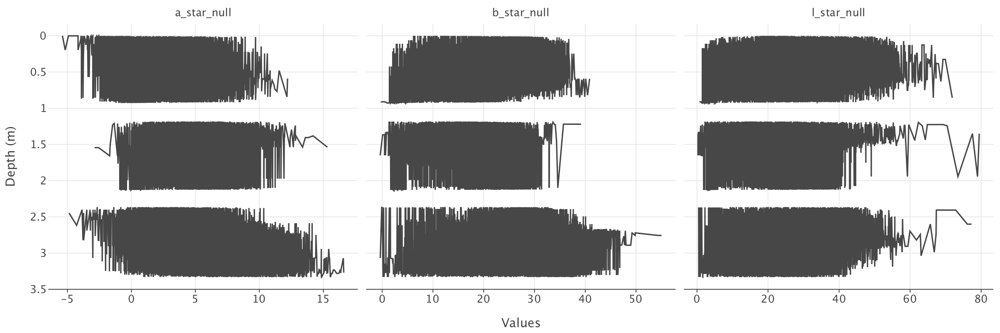

In [4]:
path = ggsave(plot, "plot_test.png")

from IPython.display import Image

Image(filename=path)

In [5]:
plot1 = (
ggplot(core_10004_1A_1, aes("value", "depth_m", group="section_no")) +
    geom_path() +
    facet_grid(x="channel", scales="free") +
    scale_y_reverse() +
    labs(x="Values", y="Depth (m)") +
    theme(legend_position="none")
)

plot1

# There should not be "Internal error: NullPointerException : <no message>"

In [6]:
plot1 = (
ggplot(core_10004_1A_1, aes("value", "depth_m", group="section_no")) +
    geom_path(sampling='none') +
    facet_grid(x="channel", scales="free") +
    scale_y_reverse() +
    labs(x="Values", y="Depth (m)") +
    theme(legend_position="none")
)

plot1

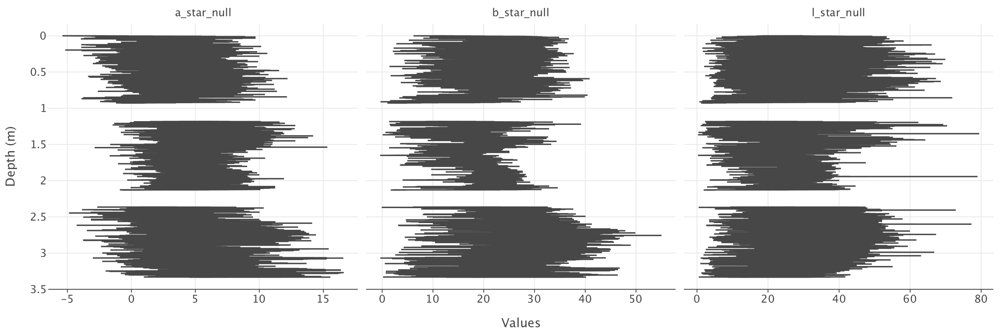

In [7]:
path1 = ggsave(plot1, "plot_test1.png")

Image(filename=path1)